<a href="https://colab.research.google.com/github/rtseeden/Image-Segmentation/blob/main/Image_Segmentation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import tensorflow as tf
import numpy as np
import glob
import datetime, os
from PIL import Image , ImageOps
import keras
from keras.callbacks import ModelCheckpoint
%load_ext tensorboard

In [2]:

from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt

x = list()
y = list()

# Add Data Here
image_dir = '/content/drive/MyDrive/Grad Classes/523 (Machine Learning)/Final Project Data/Images'
image_filenames = os.listdir( image_dir )
mask_dir='/content/drive/MyDrive/Grad Classes/523 (Machine Learning)/Final Project Data/Masks/jpg'
mask_filenames=os.listdir(mask_dir)
for filename in mask_filenames[0:200]: 
  image = Image.open(os.path.join(image_dir, filename))
  mask = Image.open(os.path.join(mask_dir, filename))
  x.append(np.asarray( image.resize((128, 128 ))))
  y.append(np.asarray(mask.resize((128 , 128))))

x = np.array( x ) / 255
y = np.array( y )



train_features, test_features, train_labels, test_labels = train_test_split(x, y,
																					test_size=0.4)

def binarize( pixel ):
    if np.array_equal( pixel , [ 128 , 0 , 0]):
        return np.array( [ 1 ] )
    else :
        return np.array( [ 0 ] )

train_labels = np.apply_along_axis( binarize , axis=3 , arr=train_labels ) 
test_labels = np.apply_along_axis( binarize , axis=3 , arr=test_labels )

In [3]:
BATCH_SIZE = 8
BUFFER_SIZE = 100
train_dataset = tf.data.Dataset.from_tensor_slices( ( train_features , train_labels ) )
train_dataset = train_dataset.cache().shuffle(BUFFER_SIZE).batch(BATCH_SIZE).repeat()
train_dataset = train_dataset.prefetch(buffer_size=tf.data.AUTOTUNE)
test_dataset = tf.data.Dataset.from_tensor_slices( ( test_features , test_labels ) )
test_dataset = test_dataset.batch(BATCH_SIZE)


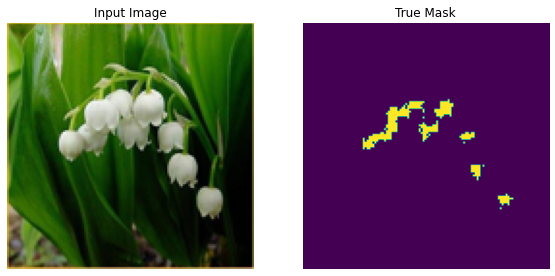

In [5]:
def display(imgs):
  plt.figure(figsize=(15, 15))
  title = ['Input Image', 'True Mask', 'Predicted Mask', 'Flower with Mask']
  for i in range(len(imgs)):
    plt.subplot(1, len(imgs)+1, i+1)
    plt.title(title[i])
    plt.imshow(tf.keras.preprocessing.image.array_to_img(imgs[i]))
    plt.axis('off')
  if (len(imgs)!= 2):
    plt.subplot(1, len(imgs)+1, 4)
    plt.title(title[3])
    plt.imshow(tf.keras.preprocessing.image.array_to_img(np.multiply(imgs[0],imgs[2])))
    plt.axis('off')
  plt.show()
sampleim, samplema = train_features[0], train_labels[0]
display([sampleim, samplema])
def accuracy(mask, predict):
  mask=np.array(mask)
  predict=np.array(predict)
  correct=0
  for i in range(128):
    for j in range(128):
      if mask[i][j]==predict[i][j]:
        correct+=1
  accuracy=correct/(128.0*128.0)
  return accuracy
def jaccards_index(mask,predict):
  mask=np.array(mask)
  predict=np.array(predict)
  correct=0
  incorrect = 0;
  for i in range(128):
    for j in range(128):
      if mask[i][j]==predict[i][j] and mask[i][j]==1:
        correct+=1
      elif mask[i][j] != predict[i][j]:
        incorrect +=1
  accuracy=(correct* 1.0)/(correct + incorrect)
  return accuracy
def display_masks(data=None, num=1):
  ave_acc=0
  ave_jac=0
  for image, mask in data.take(num):
    pred= model.predict(image)
    pred = tf.argmax(pred, axis=-1)
    pred = pred[..., tf.newaxis]
    for i in range(len(mask)):
      print("Accuracy:")
      acc=accuracy(mask[i],pred[i])
      ave_acc+=acc
      print(acc)
      print("Jaccards Index:")
      jac=jaccards_index(mask[i],pred[i])
      ave_jac+=jac
      print(jac)
      display([image[i], mask[i],pred[i]])
  print("Average Accuracy:", end=" ")
  print((1.0*ave_acc)/80*100)
  print("Average Jaccards Index:", end=" ")
  print((1.0*ave_jac)/80*100)

In [6]:
import numpy as np 
import os
import skimage.io as io
import skimage.transform as trans
import numpy as np
from keras.models import *
from keras.layers import *
from keras.optimizers import *
from keras.callbacks import ModelCheckpoint, LearningRateScheduler
def two_conv_down(input_tensor, n_filters, kernel_size = 3):
     temp= Conv2D(filters = n_filters, kernel_size = (kernel_size, kernel_size),\
              kernel_initializer = 'he_normal', padding = 'same')(input_tensor)
     temp= BatchNormalization()(temp)
     temp= Activation('relu')(temp)
     temp= Conv2D(filters = n_filters, kernel_size = (kernel_size, kernel_size),\
              kernel_initializer = 'he_normal', padding = 'same')(temp)
     temp= BatchNormalization()(temp)
     temp= Activation('relu')(temp)
     return temp
def unet(input_img):
 
    # Contracting Path
    c1 = two_conv_down(input_img,8 * 1, kernel_size = 3 )
    p1 = MaxPooling2D((2, 2))(c1)
    p1 = Dropout(0.2)(p1)
    
    c2 = two_conv_down(p1, 8 * 2, kernel_size = 3 )
    p2 = MaxPooling2D((2, 2))(c2)
    p2 = Dropout(0.2)(p2)
    
    c3 = two_conv_down(p2, 8 * 4, kernel_size = 3 )
    p3 = MaxPooling2D((2, 2))(c3)
    p3 = Dropout(0.2)(p3)
    
    c4 = two_conv_down(p3, 8 * 8, kernel_size = 3 )
    p4 = MaxPooling2D((2, 2))(c4)
    p4 = Dropout(0.2)(p4)
    
    c5 = two_conv_down(p4, 8 * 16, kernel_size = 3 )
    
    # Expansive Path
    u6 = UpSampling2D()(c5)
    u6 = Conv2D(filters = 8 *8, kernel_size = (2, 2), kernel_initializer = 'he_normal', padding = 'same')(u6)
    u6 = concatenate([u6, c4])
    u6 = Dropout(0.2)(u6)
    c6 = two_conv_down(u6, 8 * 8, kernel_size = 3 )
    
    u7 = UpSampling2D()(c6)
    u7 = Conv2D(filters = 8 *4, kernel_size = (2, 2), kernel_initializer = 'he_normal', padding = 'same')(u7)
    u7 = concatenate([u7, c3])
    u7 = Dropout(0.2)(u7)
    c7 = two_conv_down(u7, 8 * 4, kernel_size = 3 )
    
    u8 = UpSampling2D()(c7)
    u8 = Conv2D(filters = 8 *2, kernel_size = (2, 2), kernel_initializer = 'he_normal', padding = 'same')(u8)
    u8 = concatenate([u8, c2])
    u8 = Dropout(0.2)(u8)
    c8 = two_conv_down(u8, 8 * 2, kernel_size = 3 )
    
    u9 = UpSampling2D()(c8)
    u9 = Conv2D(filters = 8 *1, kernel_size = (2, 2), kernel_initializer = 'he_normal', padding = 'same')(u9)
    u9 = concatenate([u9, c1])
    u9 = Dropout(0.2)(u9)
    c9 = two_conv_down(u9, 8 * 1, kernel_size = 3 )
    
    outputs = Conv2D(4, (1, 1), activation='sigmoid')(c9)
    model = Model(inputs=[input_img], outputs=[outputs])
    return model
    


In [8]:
input_img = Input((128,128, 3), name='img')
model = unet(input_img)
model.compile(optimizer=tf.keras.optimizers.Adam(), loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])


In [9]:
TRAIN_LENGTH = len(train_labels)
STEPS_PER_EPOCH = TRAIN_LENGTH // BATCH_SIZE
EPOCHS = 50
logdir = os.path.join("logs", datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)
history=model.fit(train_dataset,steps_per_epoch= STEPS_PER_EPOCH,epochs=EPOCHS, callbacks=[tensorboard_callback])

Epoch 1/50


/usr/local/lib/python3.7/dist-packages/tensorflow/python/util/dispatch.py:1082: UserWarning: "`sparse_categorical_crossentropy` received `from_logits=True`, but the `output` argument was produced by a sigmoid or softmax activation and thus does not represent logits. Was this intended?"
  return dispatch_target(*args, **kwargs)


15/15 [==============================] - 15s 62ms/step - loss: 1.4681 - accuracy: 0.2353
Epoch 2/50
15/15 [==============================] - 1s 56ms/step - loss: 1.2538 - accuracy: 0.6519
Epoch 3/50
15/15 [==============================] - 1s 57ms/step - loss: 1.1244 - accuracy: 0.8280
Epoch 4/50
15/15 [==============================] - 1s 55ms/step - loss: 1.0022 - accuracy: 0.8687
Epoch 5/50
15/15 [==============================] - 1s 56ms/step - loss: 0.8953 - accuracy: 0.9030
Epoch 6/50
15/15 [==============================] - 1s 57ms/step - loss: 0.8158 - accuracy: 0.9063
Epoch 7/50
15/15 [==============================] - 1s 56ms/step - loss: 0.7512 - accuracy: 0.9052
Epoch 8/50
15/15 [==============================] - 1s 56ms/step - loss: 0.7005 - accuracy: 0.9064
Epoch 9/50
15/15 [==============================] - 1s 55ms/step - loss: 0.6402 - accuracy: 0.9107
Epoch 10/50
15/15 [==============================] - 1s 58ms/step - loss: 0.5956 - accuracy: 0.9135
Epoch 11/50
15/15 [

In [ ]:
%tensorboard --logdir logs

<IPython.core.display.Javascript object>

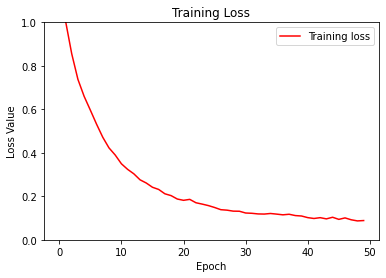

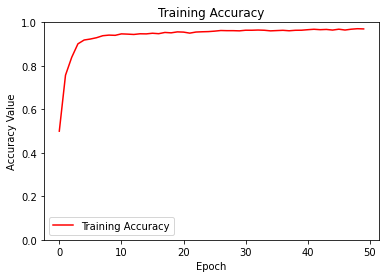

In [ ]:
loss = history.history['loss']
accuracy= history.history['accuracy']
plt.figure(1)
plt.plot(history.epoch, loss, 'r', label='Training loss')
plt.title('Training Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss Value')
plt.ylim([0, 1])
plt.legend()

plt.figure(2)
plt.plot(history.epoch, accuracy, 'r', label='Training Accuracy')
plt.title('Training Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy Value')
plt.ylim([0, 1])
plt.legend()
plt.show()

Accuracy:
0.99835205078125
Jaccards Index:
0.0


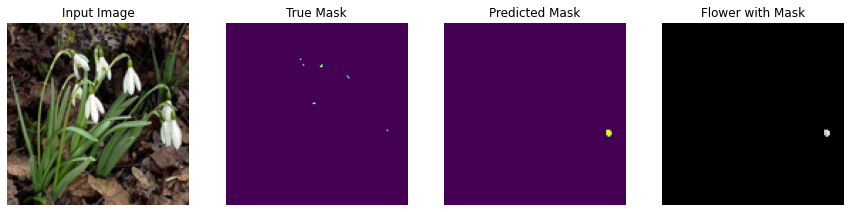

Accuracy:
0.98358154296875
Jaccards Index:
0.7017738359201774


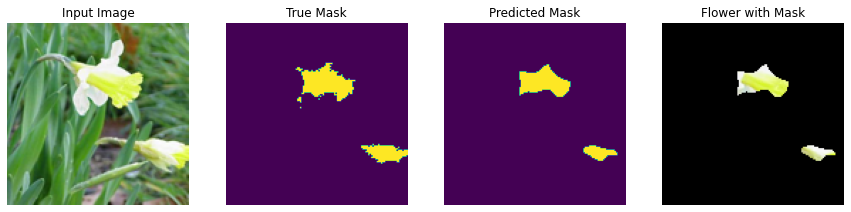

Accuracy:
0.9771728515625
Jaccards Index:
0.8394160583941606


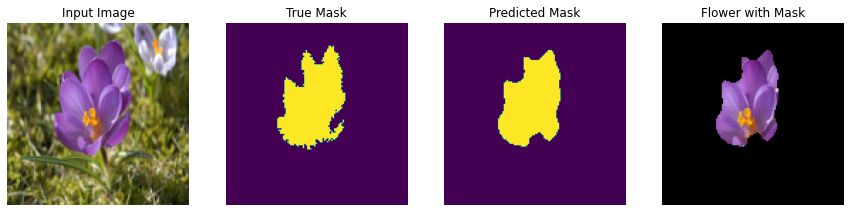

Accuracy:
0.9786376953125
Jaccards Index:
0.9154385117178062


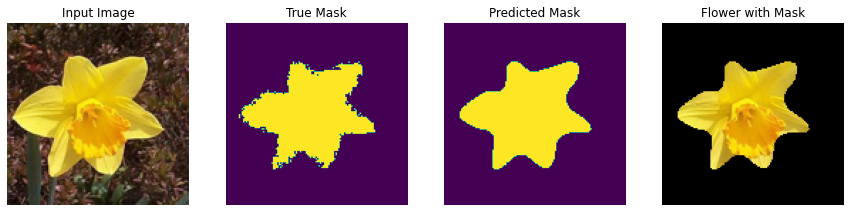

Accuracy:
0.97369384765625
Jaccards Index:
0.863391442155309


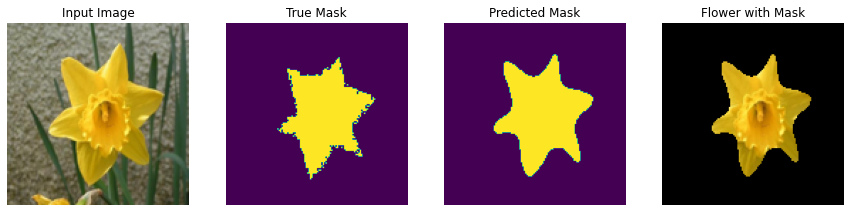

Accuracy:
0.990234375
Jaccards Index:
0.4326241134751773


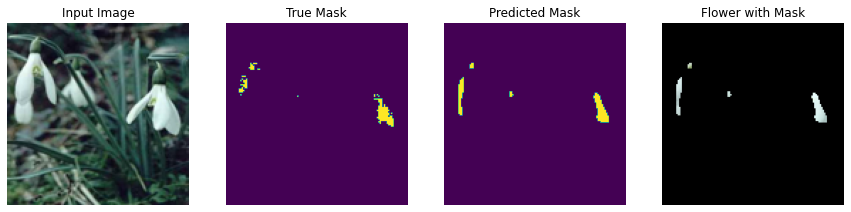

Accuracy:
0.947021484375
Jaccards Index:
0.23253757736516356


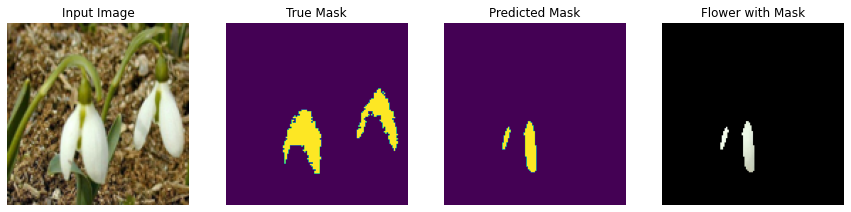

Accuracy:
0.97296142578125
Jaccards Index:
0.8697058823529412


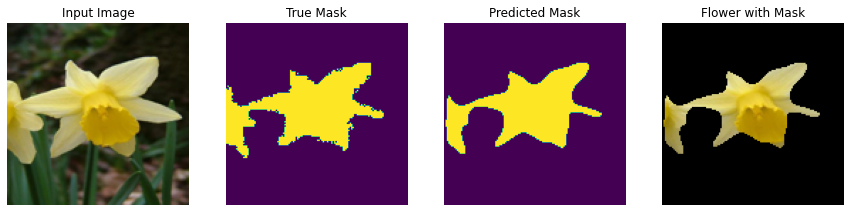

Accuracy:
0.98095703125
Jaccards Index:
0.40458015267175573


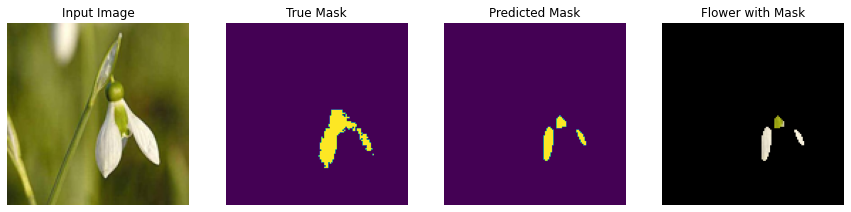

Accuracy:
0.92919921875
Jaccards Index:
0.7937411095305832


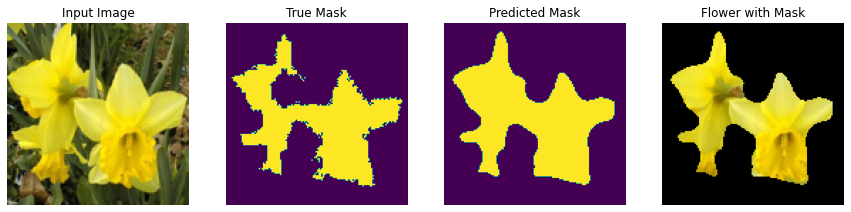

Accuracy:
0.92938232421875
Jaccards Index:
0.3865323435843054


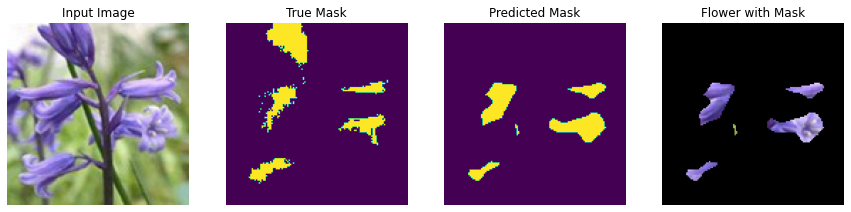

Accuracy:
0.977783203125
Jaccards Index:
0.18568232662192394


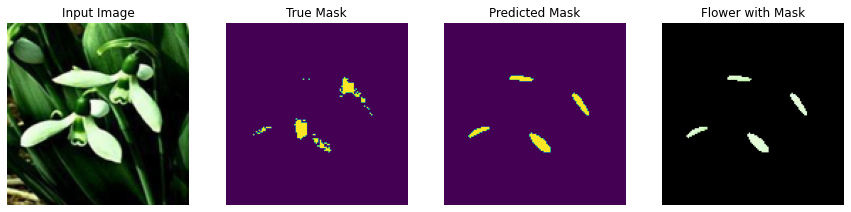

Accuracy:
0.97674560546875
Jaccards Index:
0.8329679964927663


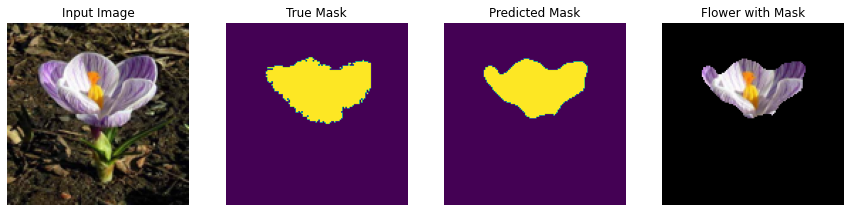

Accuracy:
0.94903564453125
Jaccards Index:
0.4899205864386072


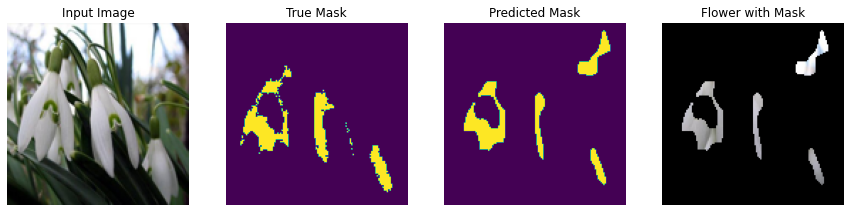

Accuracy:
0.98651123046875
Jaccards Index:
0.43478260869565216


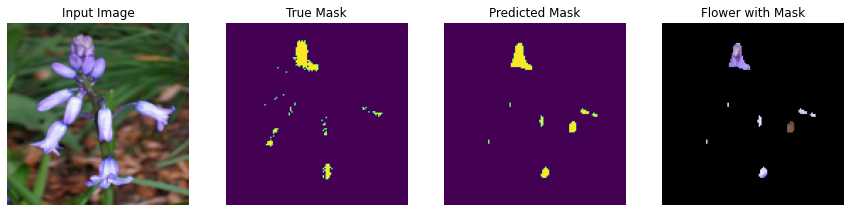

Accuracy:
0.9879150390625
Jaccards Index:
0.7585365853658537


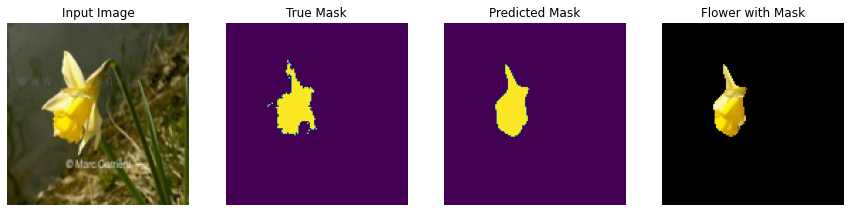

Accuracy:
0.9732666015625
Jaccards Index:
0.9251921434671221


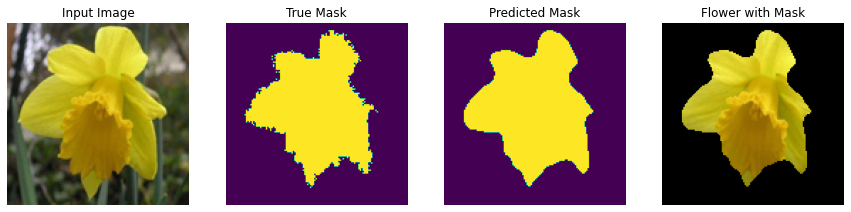

Accuracy:
0.95465087890625
Jaccards Index:
0.849534224382341


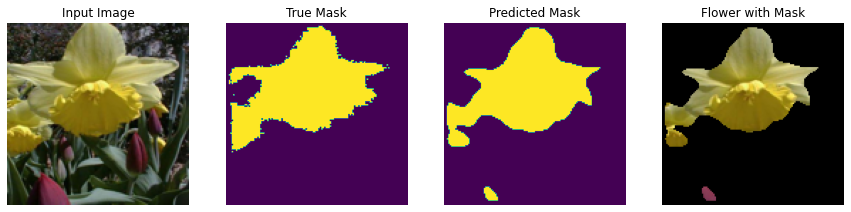

Accuracy:
0.986328125
Jaccards Index:
0.8939393939393939


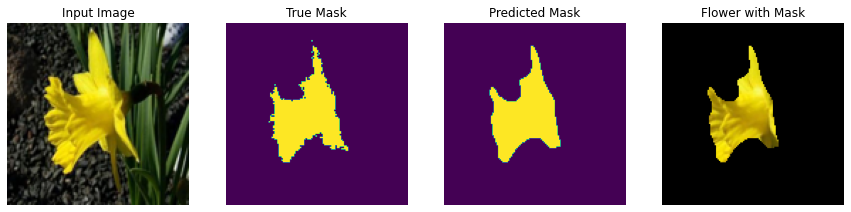

Accuracy:
0.99676513671875
Jaccards Index:
0.018518518518518517


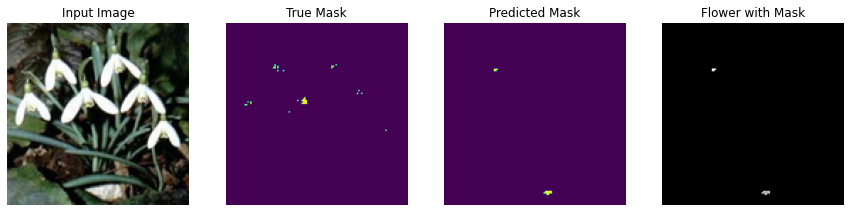

Accuracy:
0.919921875
Jaccards Index:
0.018698578908002993


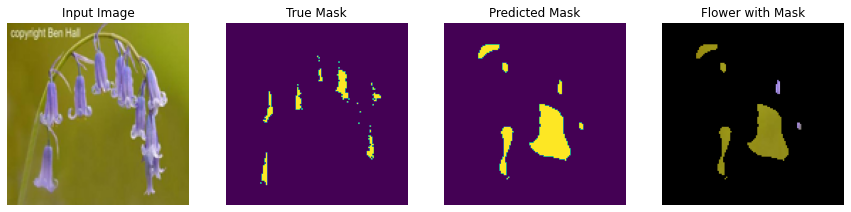

Accuracy:
0.976318359375
Jaccards Index:
0.8386694386694387


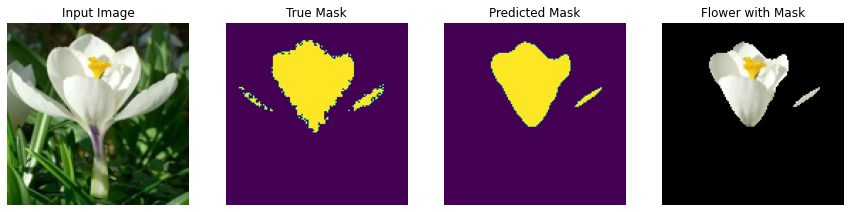

Accuracy:
0.927490234375
Jaccards Index:
0.806135770234987


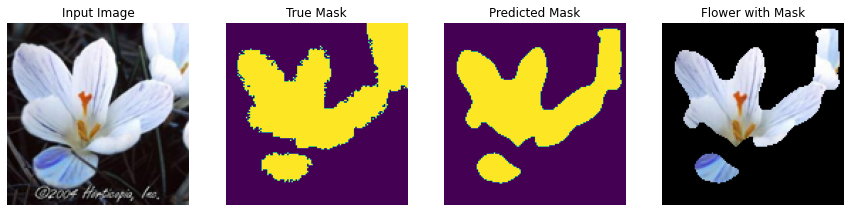

Accuracy:
0.90625
Jaccards Index:
0.6385882352941177


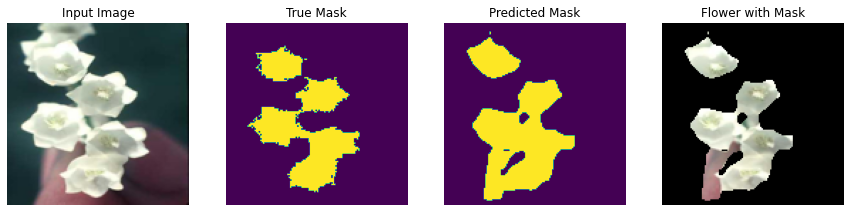

Accuracy:
0.98095703125
Jaccards Index:
0.5660639777468707


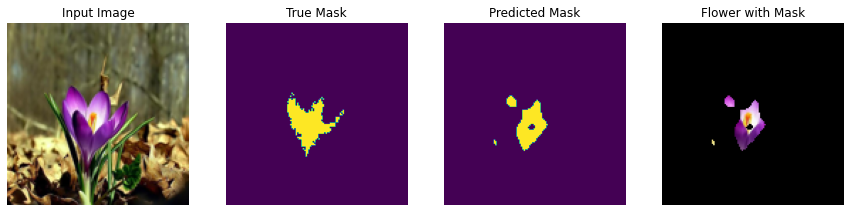

Accuracy:
0.9481201171875
Jaccards Index:
0.8987251280829263


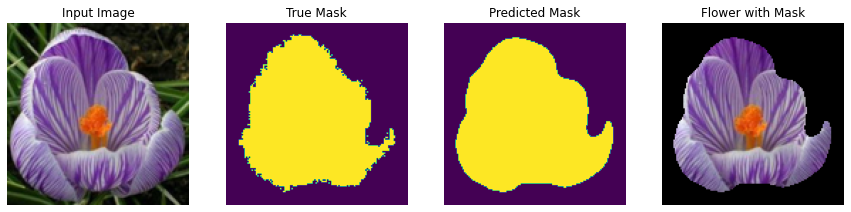

Accuracy:
0.96966552734375
Jaccards Index:
0.8214157384117858


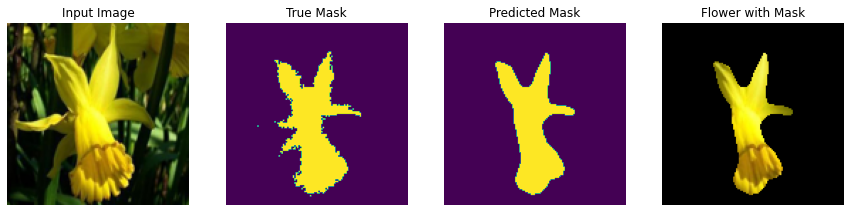

Accuracy:
0.88818359375
Jaccards Index:
0.4821933295647258


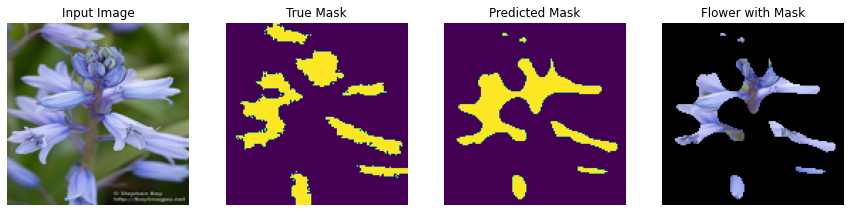

Accuracy:
0.9896240234375
Jaccards Index:
0.4879518072289157


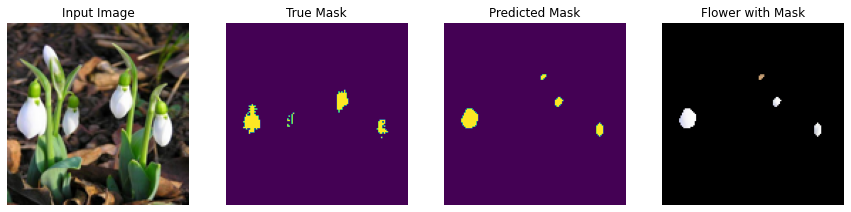

Accuracy:
0.94891357421875
Jaccards Index:
0.40806223479490805


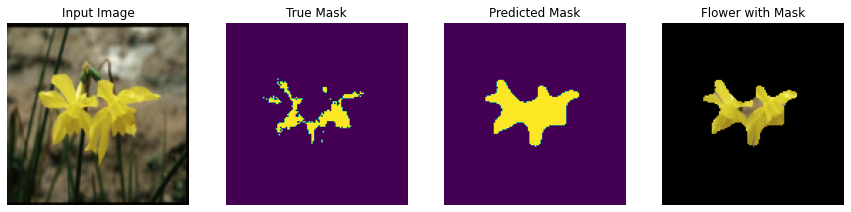

Accuracy:
0.97698974609375
Jaccards Index:
0.8908827785817656


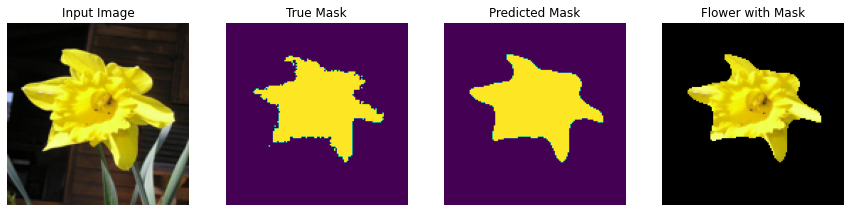

Accuracy:
0.95550537109375
Jaccards Index:
0.5629496402877698


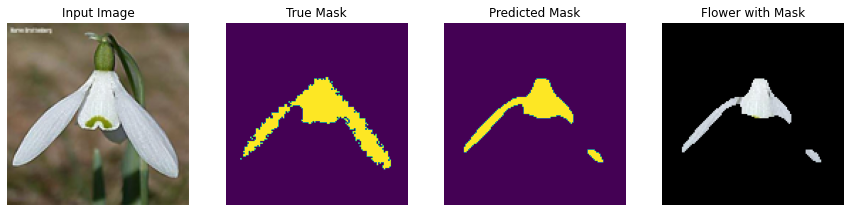

Accuracy:
0.87371826171875
Jaccards Index:
0.1288421052631579


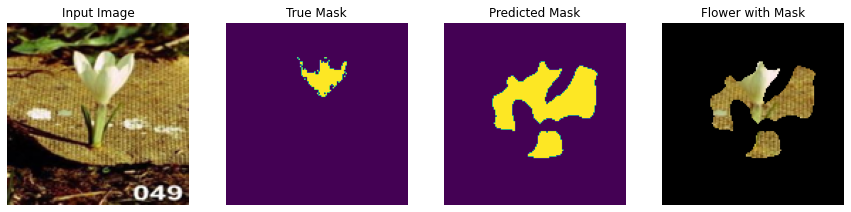

Accuracy:
0.9659423828125
Jaccards Index:
0.4276923076923077


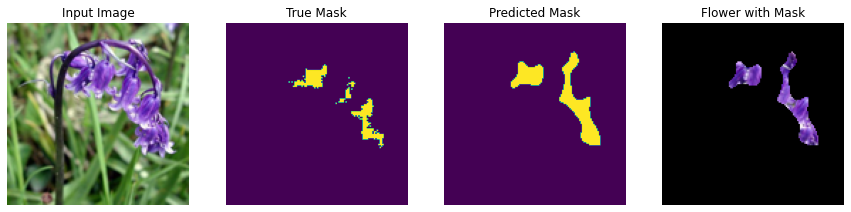

Accuracy:
0.9910888671875
Jaccards Index:
0.6784140969162996


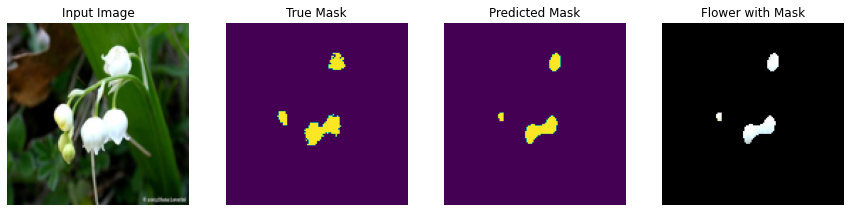

Accuracy:
0.98406982421875
Jaccards Index:
0.6851628468033776


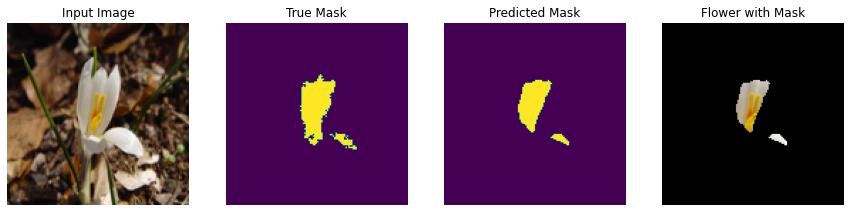

Accuracy:
0.98895263671875
Jaccards Index:
0.33941605839416056


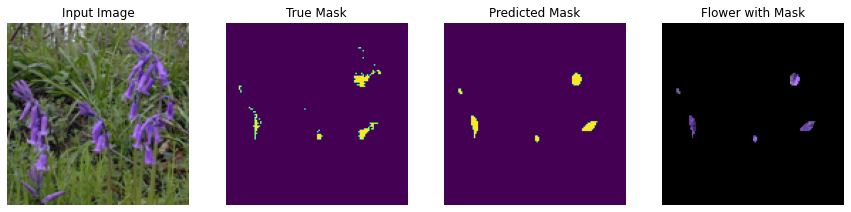

Accuracy:
0.9688720703125
Jaccards Index:
0.5633561643835616


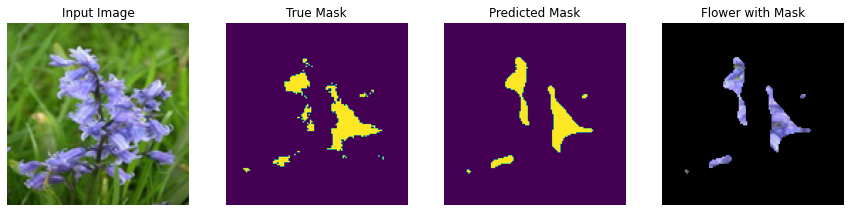

Accuracy:
0.9337158203125
Jaccards Index:
0.6963087248322147


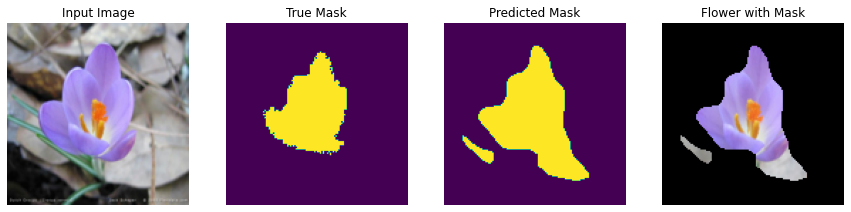

Accuracy:
0.954833984375
Jaccards Index:
0.673289183222958


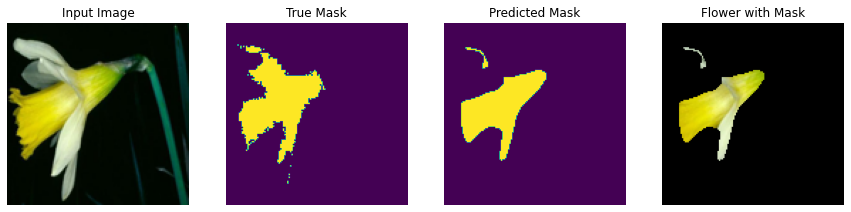

Accuracy:
0.9796142578125
Jaccards Index:
0.9020815010260921


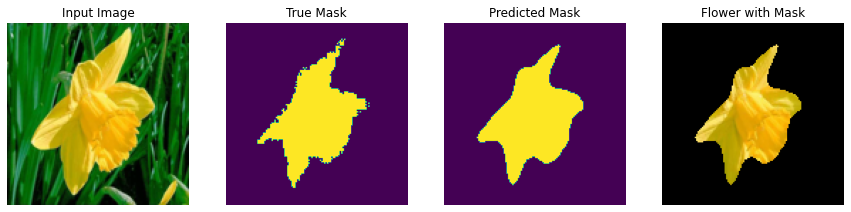

Accuracy:
0.9854736328125
Jaccards Index:
0.4292565947242206


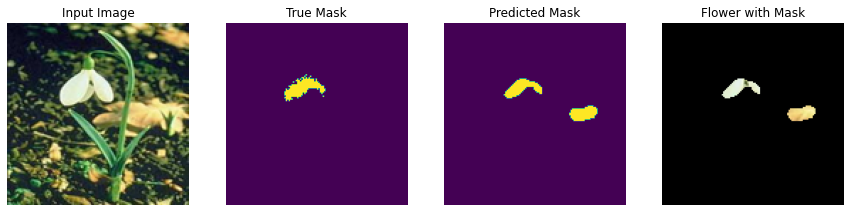

Accuracy:
0.96014404296875
Jaccards Index:
0.48944487881157156


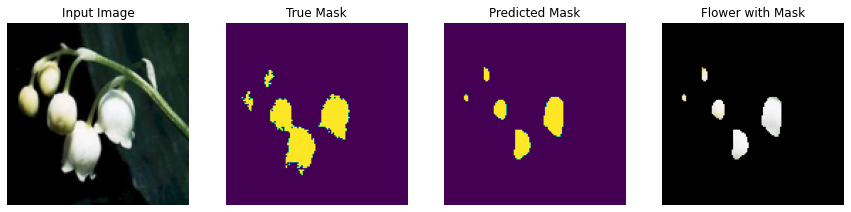

Accuracy:
0.90093994140625
Jaccards Index:
0.30641025641025643


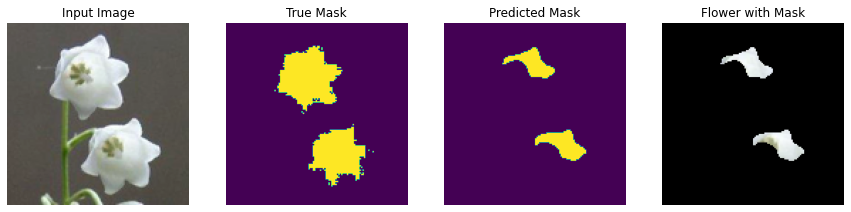

Accuracy:
0.97015380859375
Jaccards Index:
0.8912850155624722


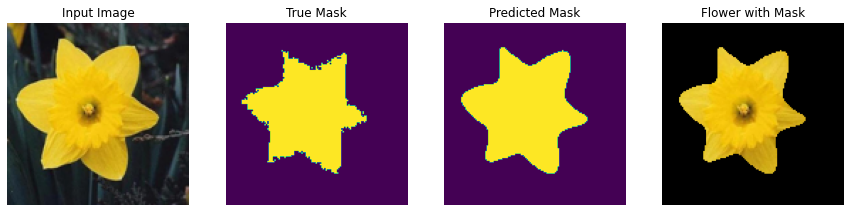

Accuracy:
0.96649169921875
Jaccards Index:
0.8633308439133682


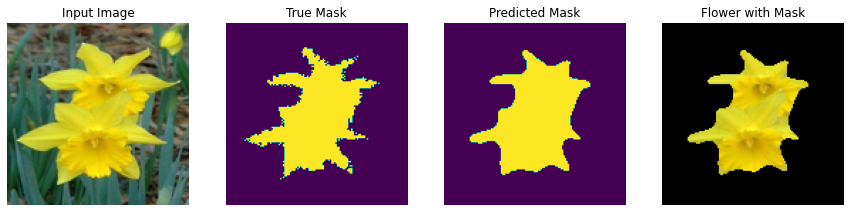

Accuracy:
0.9669189453125
Jaccards Index:
0.2924281984334204


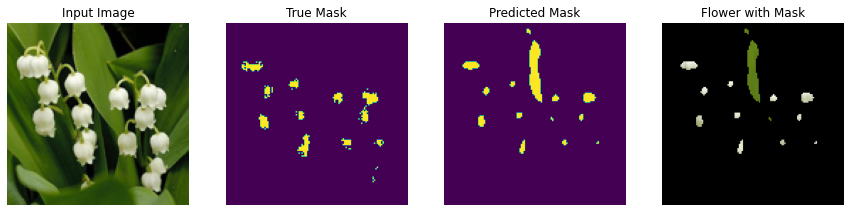

Accuracy:
0.95721435546875
Jaccards Index:
0.8620893173322841


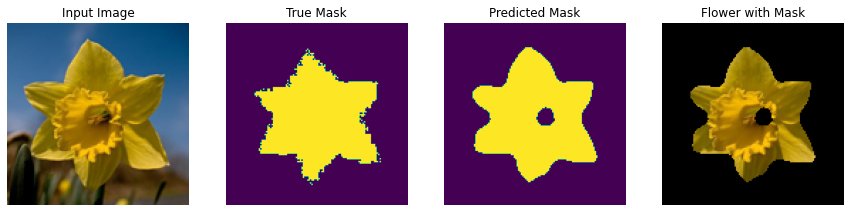

Accuracy:
0.988037109375
Jaccards Index:
0.902


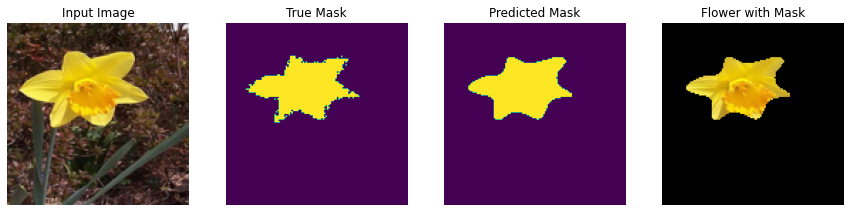

Accuracy:
0.98370361328125
Jaccards Index:
0.5197841726618705


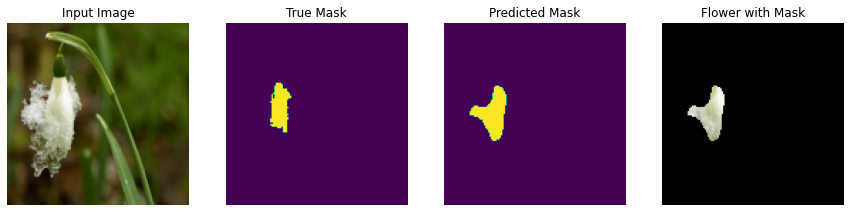

Accuracy:
0.99322509765625
Jaccards Index:
0.40641711229946526


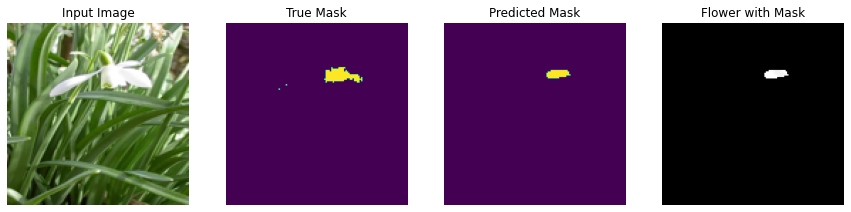

Accuracy:
0.9796142578125
Jaccards Index:
0.8756052141527002


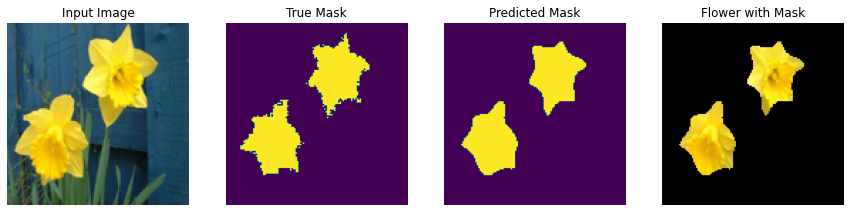

Accuracy:
0.8189697265625
Jaccards Index:
0.6961376908103678


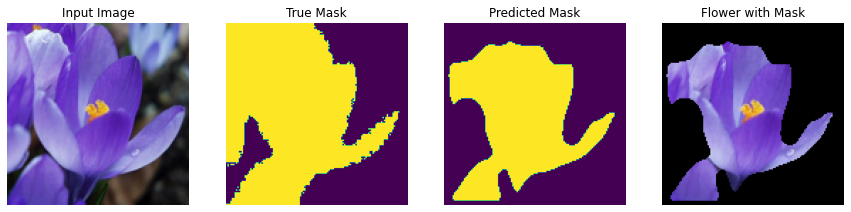

Accuracy:
0.98870849609375
Jaccards Index:
0.5219638242894057


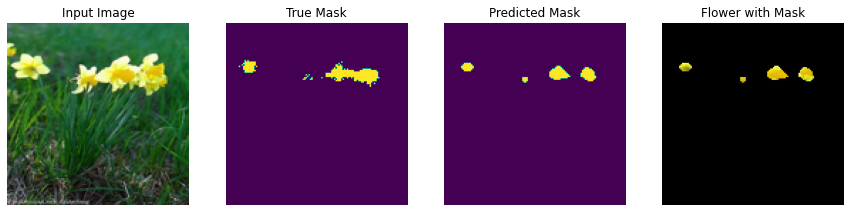

Accuracy:
0.94403076171875
Jaccards Index:
0.7503403212632725


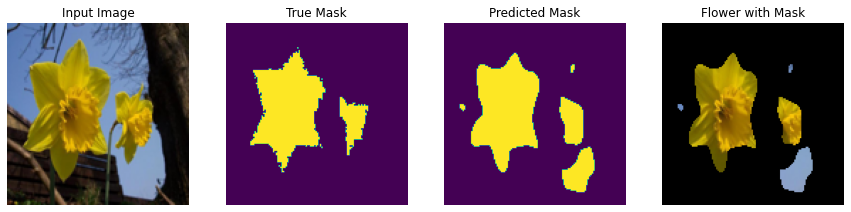

Accuracy:
0.981201171875
Jaccards Index:
0.820826061663758


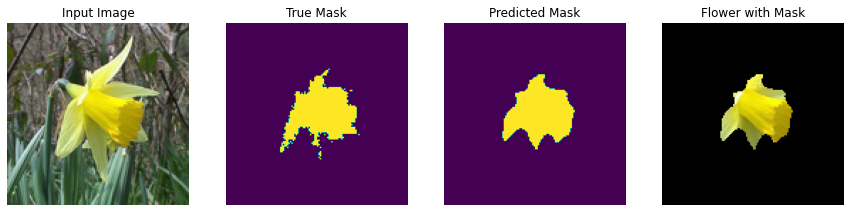

Accuracy:
0.974853515625
Jaccards Index:
0.8745814307458143


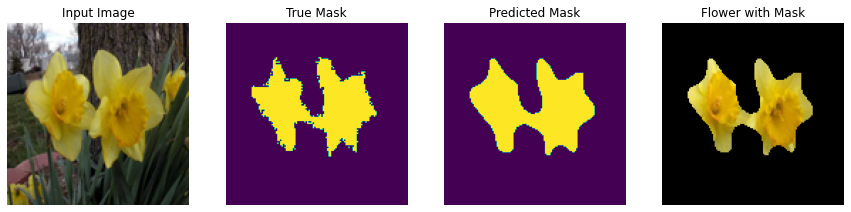

Accuracy:
0.9378662109375
Jaccards Index:
0.4840344652812975


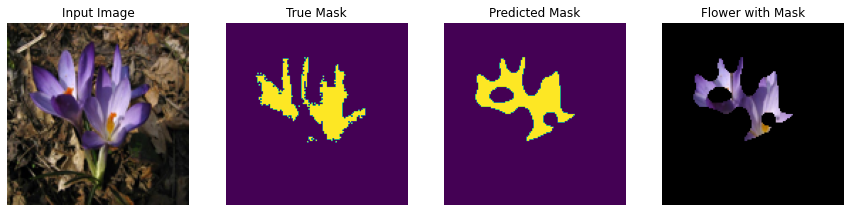

Accuracy:
0.94775390625
Jaccards Index:
0.8998244587478057


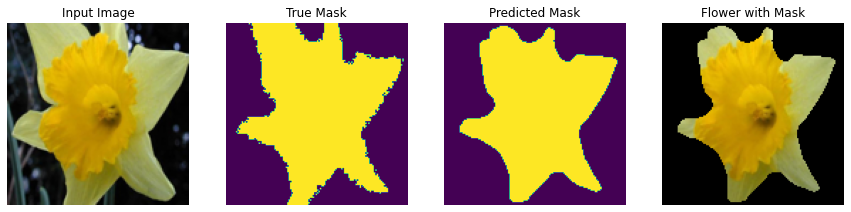

Accuracy:
0.99017333984375
Jaccards Index:
0.5985037406483791


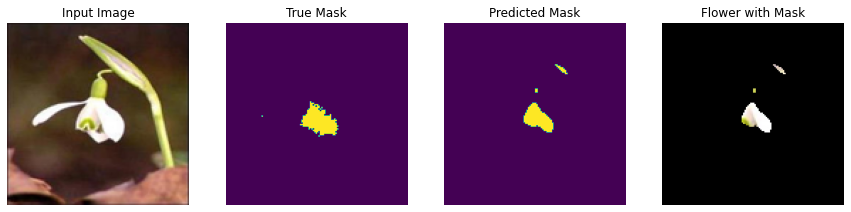

Accuracy:
0.9591064453125
Jaccards Index:
0.861598843214212


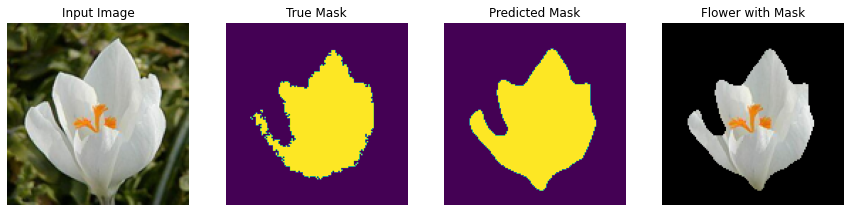

Accuracy:
0.97308349609375
Jaccards Index:
0.9044213263979194


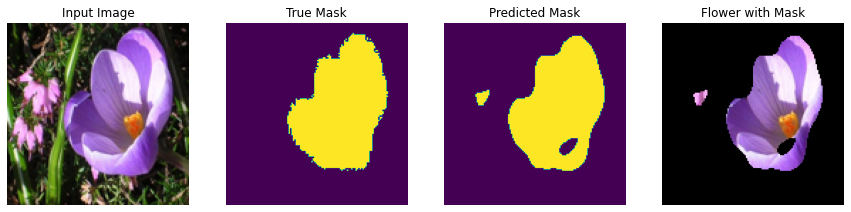

Accuracy:
0.944091796875
Jaccards Index:
0.31488406881077036


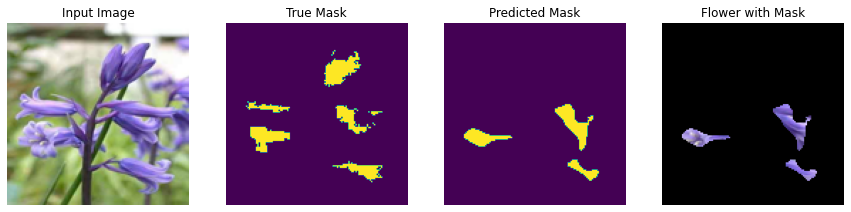

Accuracy:
0.966064453125
Jaccards Index:
0.915010700091715


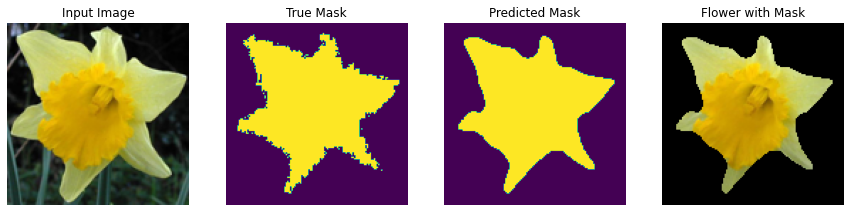

Accuracy:
0.99029541015625
Jaccards Index:
0.8441176470588235


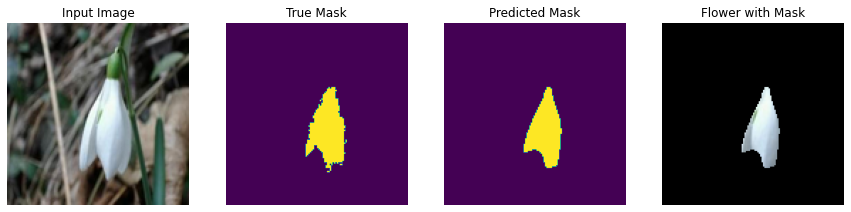

Accuracy:
0.95123291015625
Jaccards Index:
0.8179539758487127


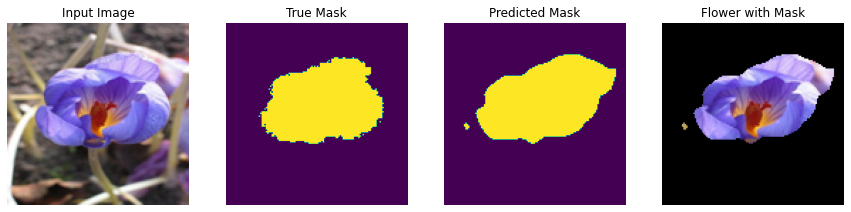

Accuracy:
0.9559326171875
Jaccards Index:
0.824969696969697


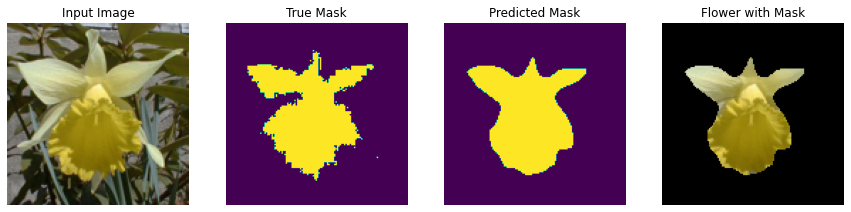

Accuracy:
0.9775390625
Jaccards Index:
0.30303030303030304


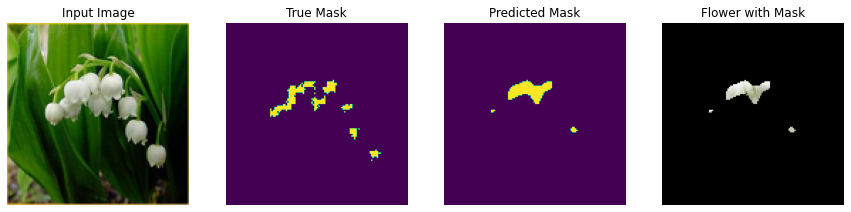

Accuracy:
0.9573974609375
Jaccards Index:
0.8860966057441253


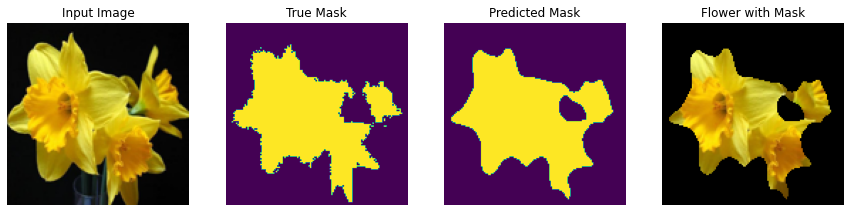

Accuracy:
0.96527099609375
Jaccards Index:
0.8713833634719711


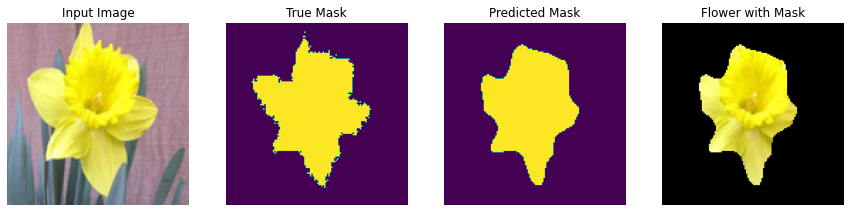

Accuracy:
0.97259521484375
Jaccards Index:
0.9123560413820028


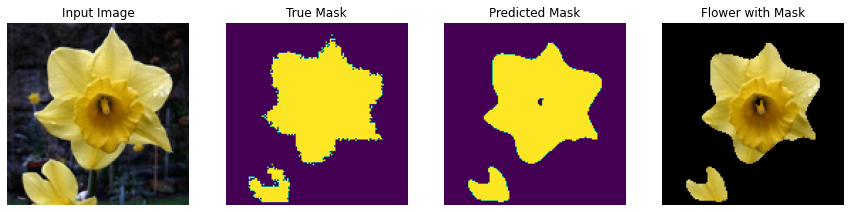

Accuracy:
0.98272705078125
Jaccards Index:
0.3229665071770335


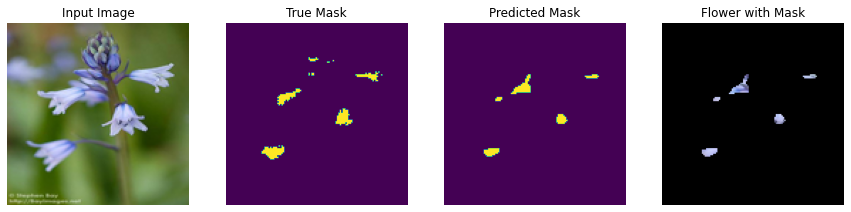

Accuracy:
0.97320556640625
Jaccards Index:
0.9166982922201139


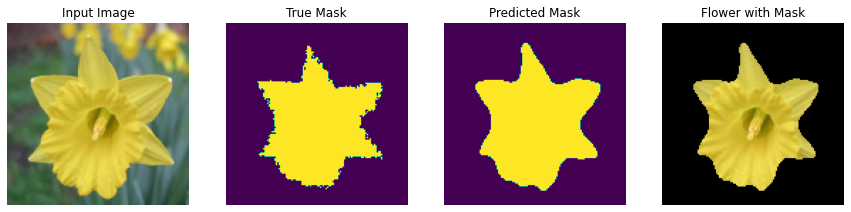

Accuracy:
0.9666748046875
Jaccards Index:
0.8842239185750637


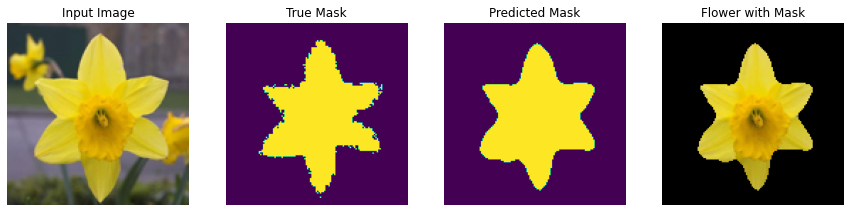

Accuracy:
0.93609619140625
Jaccards Index:
0.11421319796954314


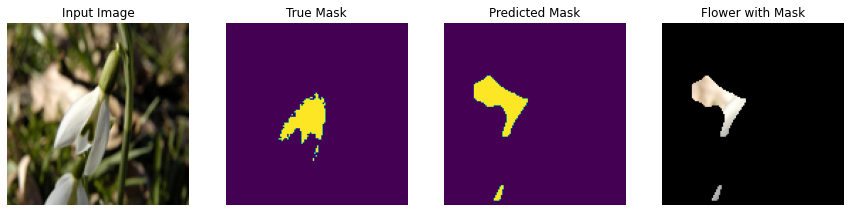

Accuracy:
0.89642333984375
Jaccards Index:
0.04823331463825014


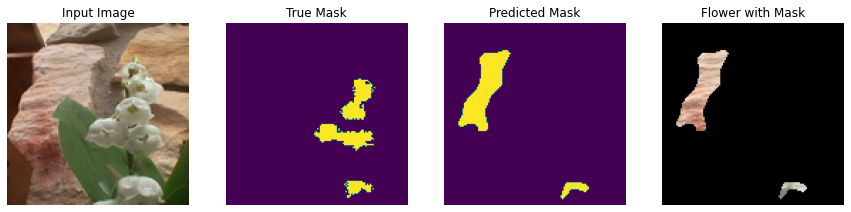

Accuracy:
0.98309326171875
Jaccards Index:
0.848302300109529


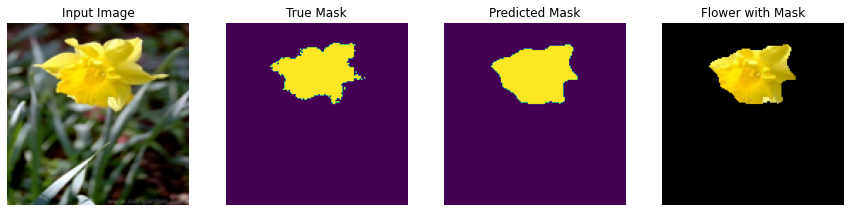

Accuracy:
0.99273681640625
Jaccards Index:
0.15602836879432624


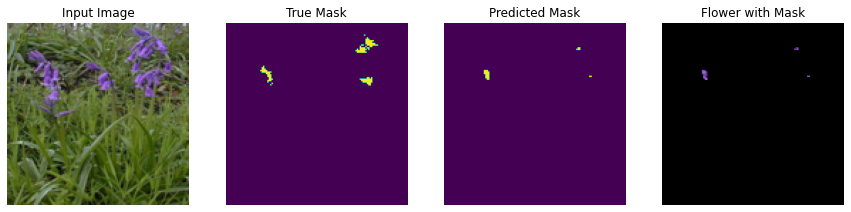

Accuracy:
0.9346923828125
Jaccards Index:
0.6819262782401903


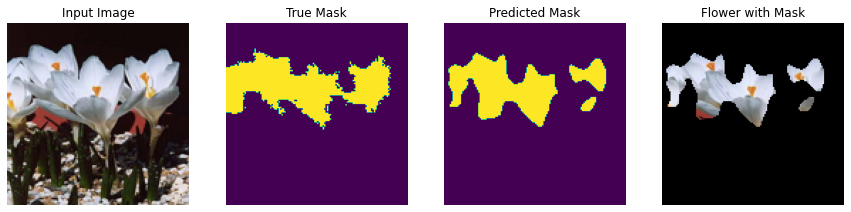

Accuracy:
0.96466064453125
Jaccards Index:
0.5195020746887967


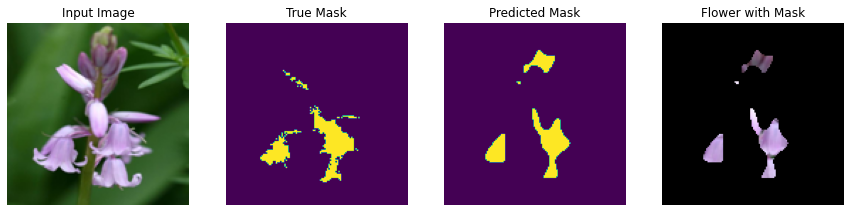

Average Accuracy: 96.19667053222656
Average Jaccards Index: 62.21986934951841


In [ ]:
display_masks(test_dataset,10)